# PREP

In [1]:
import random
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from wildlifeml.utils.io import (
    load_csv, 
    load_json, 
    load_pickle,
    load_image,
)
from wildlifeml.data import subset_dataset
from wildlifeml.utils.datasets import render_bbox, map_bbox_to_img, separate_empties
from wildlifeml.preprocessing.cropping import Cropper

2023-07-19 15:53:22.428168: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2023-07-19 15:53:25.167764: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-07-19 15:53:25.167982: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2023-07-19 15:53:25.207437: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:18:00.0 name: GeForce RTX 2080 Ti computeCapability: 7.5
coreClock: 1.545GHz coreCount: 68 deviceMemorySize: 10.76GiB deviceMemoryBandwidth: 573.69GiB/s
2023-07-19 15:53:25.207955: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 1 with properties: 
pciBusID: 0000:3b:00.0 name: GeForce RTX 2080 Ti computeCapability: 7.5
coreClock: 1.545GHz coreCount: 68 deviceMemorySize: 10.76GiB deviceMemoryBandwidth: 573.69GiB/s
2023-

In [3]:
REPODIR = '/home/wimmerl/projects/wildlife-experiments'
IMGDIR = '/common/bothmannl/wildlife_images/usecase2/original_images/'
CFG = load_json(os.path.join(REPODIR, 'configs/cfg.json'))

In [13]:
LABEL_MAP = load_json(os.path.join(CFG['data_dir'], 'label_map_names.json'))
LABEL_DICT = {k: v for k, v in load_csv(os.path.join(CFG['data_dir'], CFG['label_file']))}
MAPPING_DICT = load_json(os.path.join(CFG['data_dir'], CFG['mapping_file']))
DETECTOR_DICT = load_json(os.path.join(CFG['data_dir'], CFG['detector_file']))
META_DF = pd.read_csv(os.path.join(CFG['data_dir'], 'metadata.csv'))

# DESCRIPTIVE

## STATS

In [8]:
META_DF.groupby(['station'])['orig_name'].count()

station
h500ee05127658    15551
h500ee05127823     1607
h500ee07133258     1548
h500ee07133290    15712
h500ee07133326    12293
                  ...  
p850hj01248970       41
p850hj01248991       15
p850hj01248995       48
p850hj01248996       22
p850hj01249096      175
Name: orig_name, Length: 73, dtype: int64

In [14]:
STATIONS_SPLIT = load_json(os.path.join(CFG['data_dir'], 'stations_split.json'))

In [16]:
META_DF = META_DF.loc[~META_DF['true_class'].isin([1, 6])]

In [17]:
META_DF.loc[META_DF['station'].isin(STATIONS_SPLIT['STATIONS_IS'])].groupby(['true_class'])['orig_name'].count()

true_class
0     9610
2     6494
3      422
4    11278
5      826
Name: orig_name, dtype: int64

In [18]:
META_DF.loc[META_DF['station'].isin(STATIONS_SPLIT['STATIONS_OOS'])].groupby(['true_class'])['orig_name'].count()

true_class
0    105338
2     38587
3       634
4     59635
5      7503
Name: orig_name, dtype: int64

In [140]:
cnt_ins_oos = META_DF.groupby(['station_set', 'true_class'])['orig_name'].count()
cnt_ins_oos, cnt_ins_oos.groupby(['true_class']).sum()  # Table 1

(station_set  true_class   
 s1           empty            15627
              european_hare      485
              others             941
              red_deer            26
              red_fox            708
              red_squirrel       297
              roe_deer          6074
              wild_boar          210
 s2           empty            14274
              european_hare      255
              others            1051
              red_deer           135
              red_fox            106
              red_squirrel        13
              roe_deer          7010
              wild_boar          904
 Name: orig_name, dtype: int64,
 true_class
 empty            29901
 european_hare      740
 others            1992
 red_deer           161
 red_fox            814
 red_squirrel       310
 roe_deer         13084
 wild_boar         1114
 Name: orig_name, dtype: int64)

In [164]:
dataset_oos_trainval = load_pickle(os.path.join(REPODIR, 'data', 'dataset_oos_trainval.pkl'))
_, keys_all_nonempty = separate_empties(os.path.join(CFG['data_dir'], CFG['detector_file']), float(0.5))
keys_oos_trainval = list(set(dataset_oos_trainval.keys).intersection(set(keys_all_nonempty)))
dataset_oos_trainval = subset_dataset(dataset_oos_trainval, keys_oos_trainval)
len(set(map_bbox_to_img(dataset_oos_trainval.keys)))

10020

## EXEMPLARY MISCLASSIFIED CASES

In [165]:
results = load_pickle('results/passive/50/202303160957_insample_test_123.pkl')
OUR_THRESH = 0.5

In [166]:
def sort_results(dict_preds, truth):
    ordered_dict = {k: dict_preds[k] for k in sorted(list(dict_preds.keys()))}
    ordered_array = np.concatenate([x.reshape(1, len(LABEL_MAP)) for x in list(ordered_dict.values())])
    ordered_list = [truth[k] for k in [list(dict_preds.keys()).index(i) for i in sorted(list(dict_preds.keys()))]]
    return ordered_array, ordered_list

# TODO speichern regeln, coord sys, img name weg !!!!

In [184]:
def inspect_images(
    results, 
    true_label: str, 
    label_map: dict, 
    mapping_dict: dict,
    detector_dict: dict,
    n_displays: int, 
    img_dir: str,
    is_misclassified: bool,
    sorting: str,  # ['asc', 'desc', 'rand'],
    min_conf: float = 0.,
    max_conf: float = 1.
):
    preds_imgs_ppl, truth_imgs_ppl = sort_results(results['preds_imgs_ppl'], results['truth_imgs_ppl'])
    result_ranking = pd.DataFrame(
        zip(
            sorted(list(results['preds_imgs_ppl'].keys())), 
            [np.argmax(v) for v in preds_imgs_ppl],
            [np.max(v) for v in preds_imgs_ppl],
            truth_imgs_ppl,
        ),
        columns=['img', 'pred_label', 'conf', 'true_label']
    )
    result_ranking = result_ranking.loc[result_ranking['true_label'] == label_map[true_label]]
    if is_misclassified:
        result_ranking = result_ranking.loc[result_ranking['pred_label'] != label_map[true_label]]

    if sorting == 'asc':
        img_keys = result_ranking.sort_values('conf')['img'][:n_displays]
    elif sorting == 'desc':
        img_keys = result_ranking.sort_values('conf', ascending=False)['img'][:n_displays]
    else: 
        img_keys = random.sample(list(result_ranking['img']), n_displays)

    result_dict = {}
    for idx, k in enumerate(img_keys):
        pred_class = np.argmax(preds_imgs_ppl[idx, ...])
        bbox_keys = mapping_dict[k]
        fig, ax = plt.subplots()
        ax.set_yticks([])
        ax.set_xticks([])
        img = load_image(os.path.join(img_dir, k))
        width, height = img.size
        x_coords, y_coords = [], []
        for bkey in bbox_keys:
            bbox = detector_dict[bkey].get('bbox')
            if bbox is not None:
                x, y = Cropper.get_absolute_coords(detector_dict[bkey].get('bbox'), (height, width))
                x_coords.append(x)
                y_coords.append(y)
        img = render_bbox(img, x_coords, y_coords)
        ax.imshow(img)
        plt.show()
        plt.close()
        pred_class = result_ranking.loc[result_ranking['img'] == k, 'pred_label'].values[0]
        pred_class_name = [k for k, v in label_map.items() if v == pred_class][0]
        conf = result_ranking.loc[result_ranking['img'] == k]['conf'].item()
        result_dict.update({k: img})
        print(
            f'Image: {k}\nTrue: {true_label}\nPredicted: {pred_class_name}\nConfidence: {conf:.2f}'
        )
    return result_dict

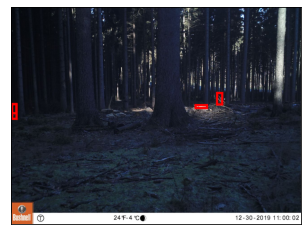

Image: 7254_12300188.JPG
True: empty
Predicted: roe_deer
Confidence: 0.77


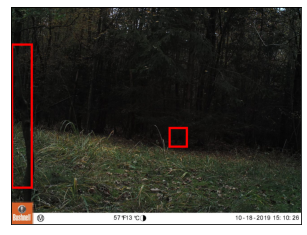

Image: 49404_10180570.JPG
True: empty
Predicted: others
Confidence: 0.99


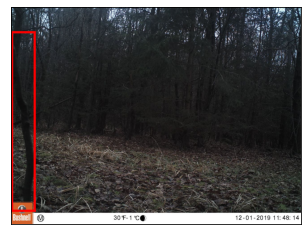

Image: 49596_12010440.JPG
True: empty
Predicted: others
Confidence: 0.82


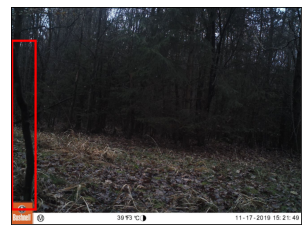

Image: 49377_11170209.JPG
True: empty
Predicted: others
Confidence: 0.74


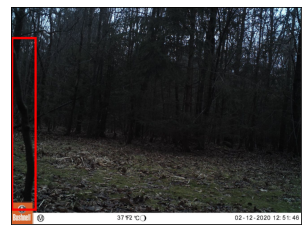

Image: 48549_02120007.JPG
True: empty
Predicted: others
Confidence: 0.89


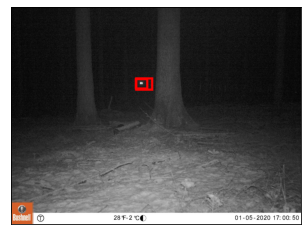

Image: 5452_01050817.JPG
True: empty
Predicted: others
Confidence: 0.66


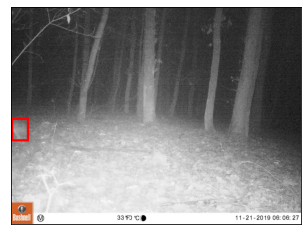

Image: 18127_11210457.JPG
True: empty
Predicted: others
Confidence: 0.66


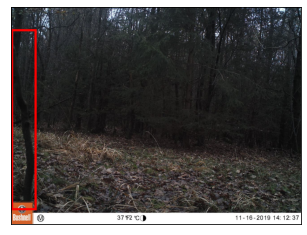

Image: 50534_11160156.JPG
True: empty
Predicted: others
Confidence: 0.91


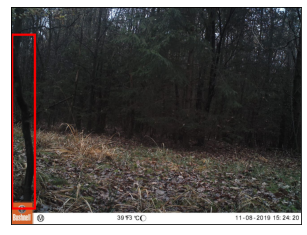

Image: 49977_11080969.JPG
True: empty
Predicted: others
Confidence: 0.97


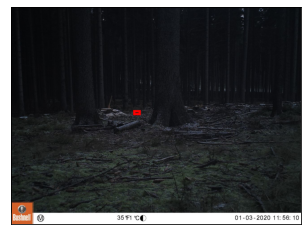

Image: 4405_01030621.JPG
True: empty
Predicted: roe_deer
Confidence: 0.81


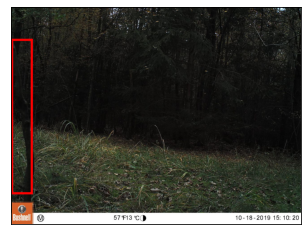

Image: 47992_10180567.JPG
True: empty
Predicted: others
Confidence: 0.99


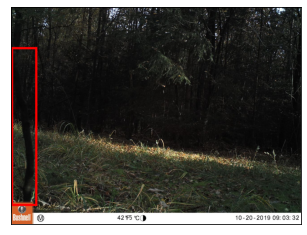

Image: 49889_10200599.JPG
True: empty
Predicted: others
Confidence: 0.99


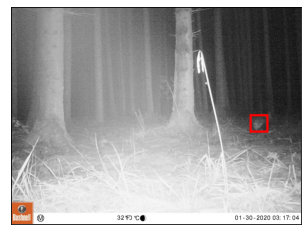

Image: 55454_01300068.JPG
True: empty
Predicted: others
Confidence: 0.98


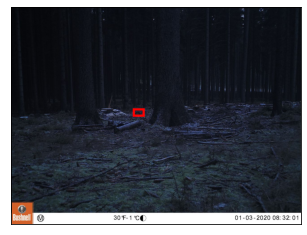

Image: 3468_01030472.JPG
True: empty
Predicted: roe_deer
Confidence: 1.00


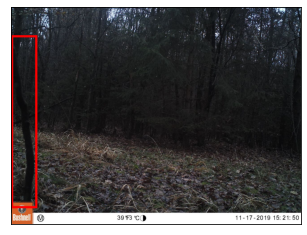

Image: 49869_11170210.JPG
True: empty
Predicted: others
Confidence: 0.87


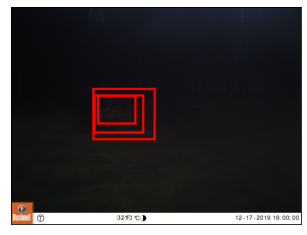

Image: 7251_12170667.JPG
True: empty
Predicted: roe_deer
Confidence: 0.60


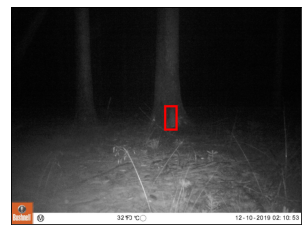

Image: 5497_12100348.JPG
True: empty
Predicted: roe_deer
Confidence: 0.94


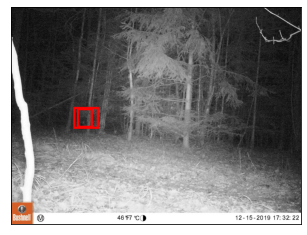

Image: 47232_12150780.JPG
True: empty
Predicted: roe_deer
Confidence: 0.89


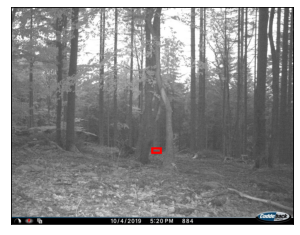

Image: 3001_I_00007b.JPG
True: empty
Predicted: roe_deer
Confidence: 0.95


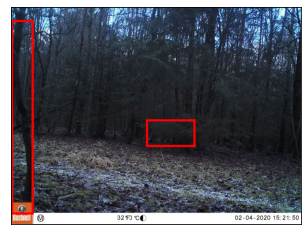

Image: 50044_02040815.JPG
True: empty
Predicted: others
Confidence: 0.64


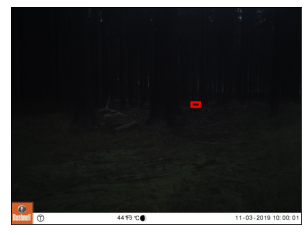

Image: 3796_11030853.JPG
True: empty
Predicted: others
Confidence: 0.39


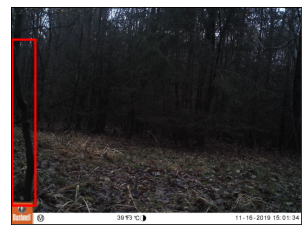

Image: 50068_11160200.JPG
True: empty
Predicted: others
Confidence: 0.94


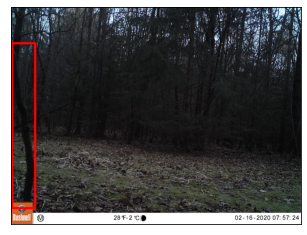

Image: 48471_02160074.JPG
True: empty
Predicted: others
Confidence: 0.90


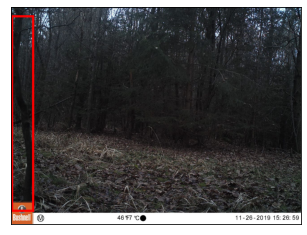

Image: 46755_11260357.JPG
True: empty
Predicted: others
Confidence: 0.76


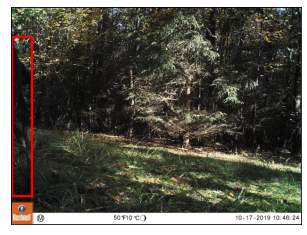

Image: 50486_10170509.JPG
True: empty
Predicted: others
Confidence: 0.99


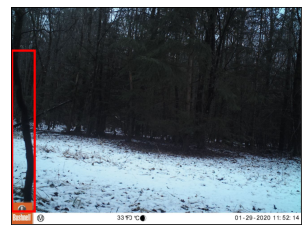

Image: 47884_01290669.JPG
True: empty
Predicted: others
Confidence: 0.82


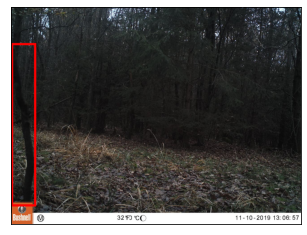

Image: 47381_11100034.JPG
True: empty
Predicted: others
Confidence: 0.93


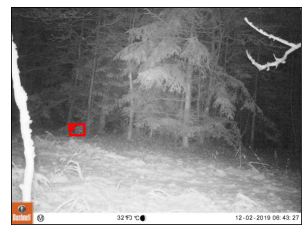

Image: 50513_12020494.JPG
True: empty
Predicted: others
Confidence: 0.48


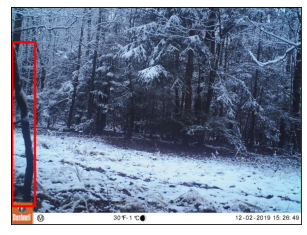

Image: 47686_12020506.JPG
True: empty
Predicted: roe_deer
Confidence: 0.46


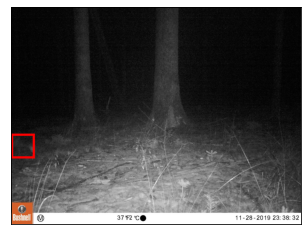

Image: 4830_11280861.JPG
True: empty
Predicted: roe_deer
Confidence: 0.81


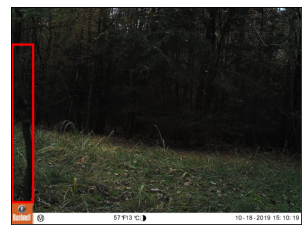

Image: 47217_10180566.JPG
True: empty
Predicted: others
Confidence: 0.99


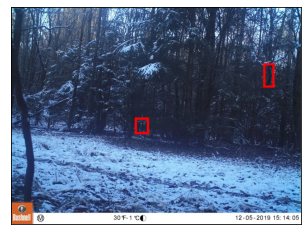

Image: 46639_12050552.JPG
True: empty
Predicted: others
Confidence: 0.59


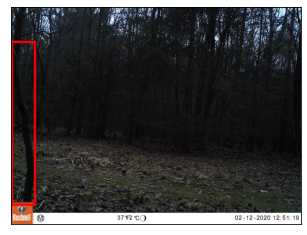

Image: 49925_02120002.JPG
True: empty
Predicted: others
Confidence: 0.85


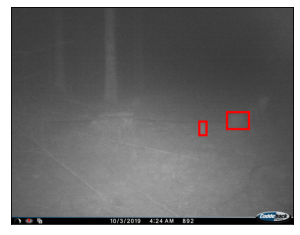

Image: 11121_I_00028b.JPG
True: empty
Predicted: roe_deer
Confidence: 0.59


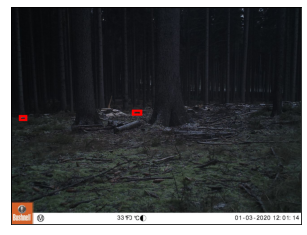

Image: 6870_01030649.JPG
True: empty
Predicted: roe_deer
Confidence: 0.80


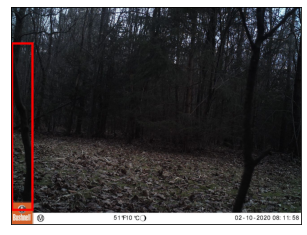

Image: 47175_02100967.JPG
True: empty
Predicted: others
Confidence: 0.92


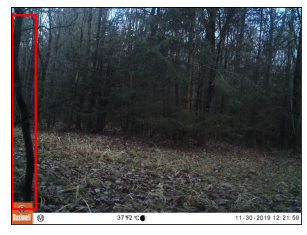

Image: 46730_11300423.JPG
True: empty
Predicted: others
Confidence: 0.90


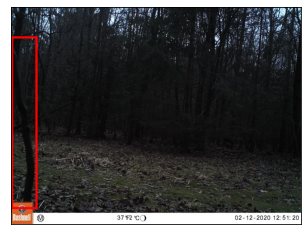

Image: 48808_02120003.JPG
True: empty
Predicted: others
Confidence: 0.85


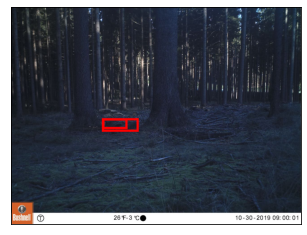

Image: 5392_10300713.JPG
True: empty
Predicted: roe_deer
Confidence: 0.89


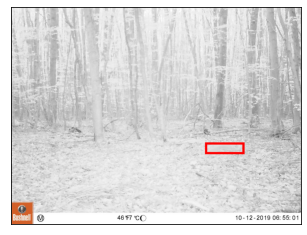

Image: 8234_10120079.JPG
True: empty
Predicted: red_fox
Confidence: 0.53


In [210]:
random.seed(456)
true_empty = inspect_images(
    results=results, 
    true_label='empty',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=40,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

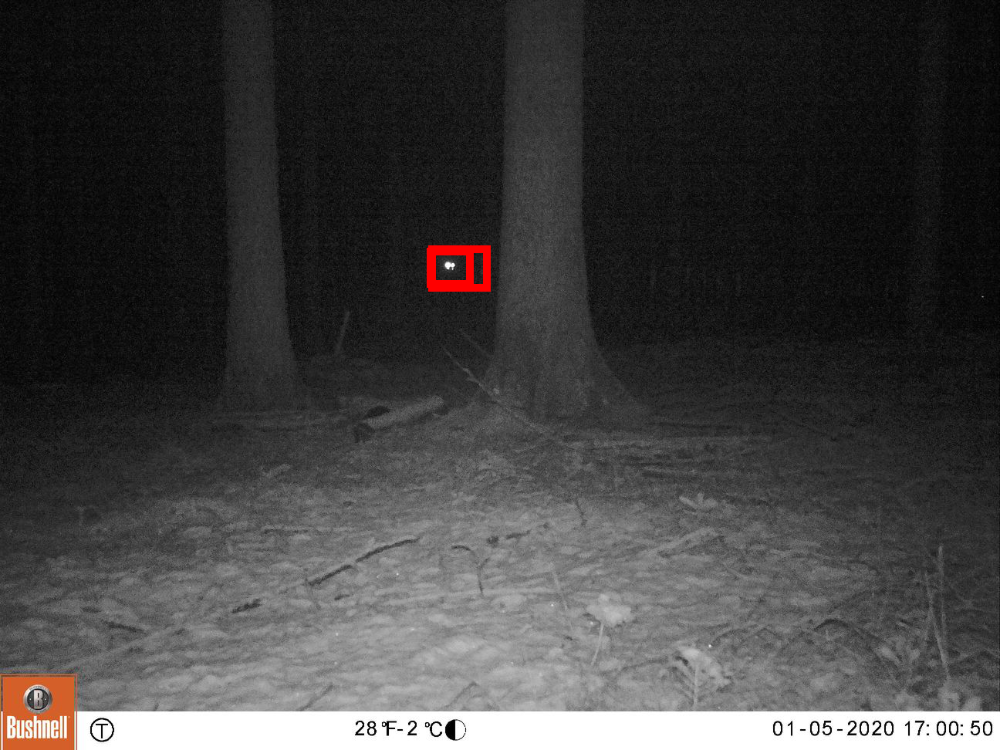

In [212]:
true_empty ['5452_01050817.JPG'] # wrong true label

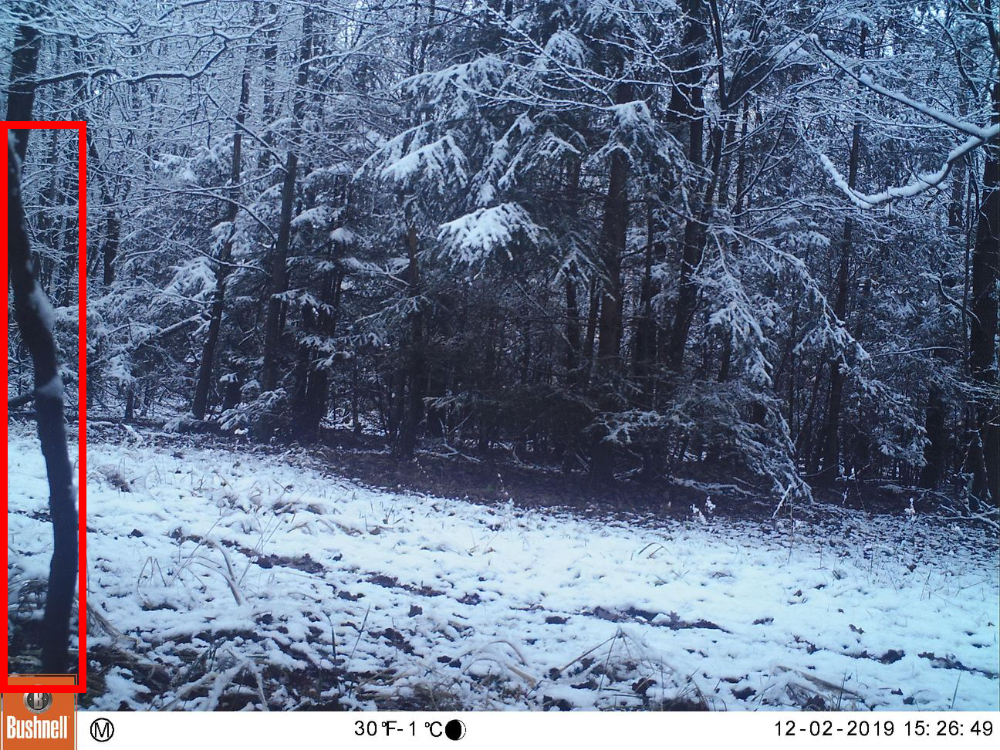

In [213]:
true_empty['47686_12020506.JPG'] # wrong bbox

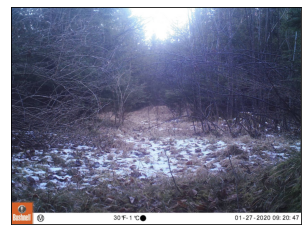

Image: 57922_01270525.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


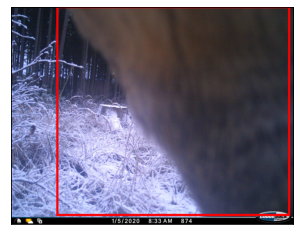

Image: 649_I_00165a.JPG
True: roe_deer
Predicted: others
Confidence: 0.85


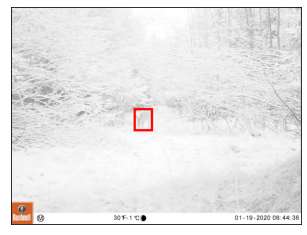

Image: 57141_01190886.JPG
True: roe_deer
Predicted: red_fox
Confidence: 1.00


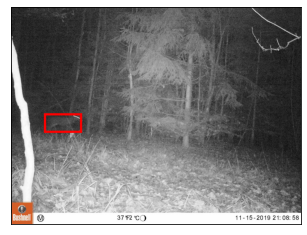

Image: 49554_11150121.JPG
True: roe_deer
Predicted: others
Confidence: 0.51


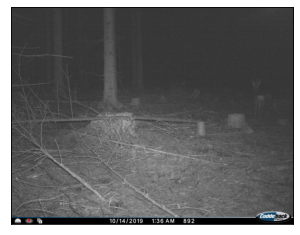

Image: 11100_I_00041c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


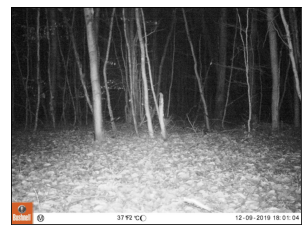

Image: 7832_12090323.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


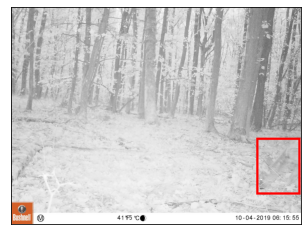

Image: 17690_10040020.JPG
True: roe_deer
Predicted: others
Confidence: 0.56


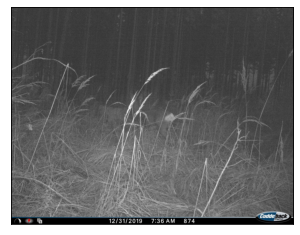

Image: 425_I_00149b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


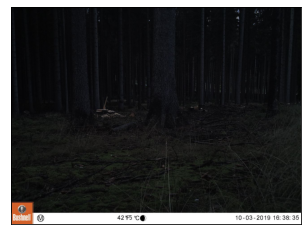

Image: 6875_10030505.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


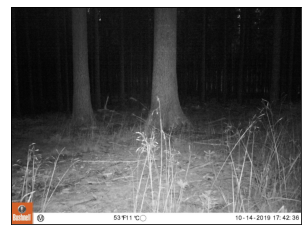

Image: 4935_10140051.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


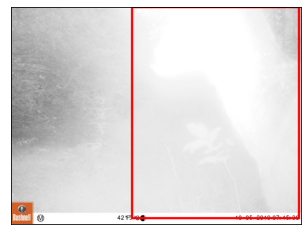

Image: 121505_10050362.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


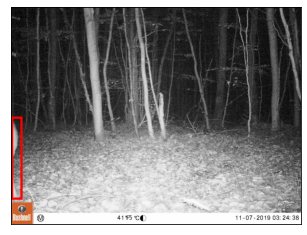

Image: 7904_11070177.JPG
True: roe_deer
Predicted: others
Confidence: 0.54


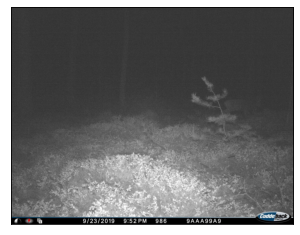

Image: 39316_I_00012c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


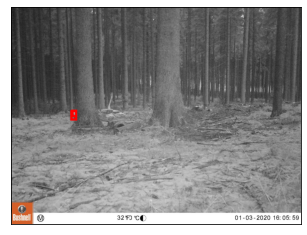

Image: 4595_01030668.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


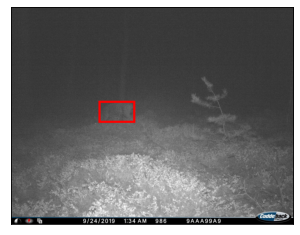

Image: 39311_I_00016b.JPG
True: roe_deer
Predicted: wild_boar
Confidence: 0.99


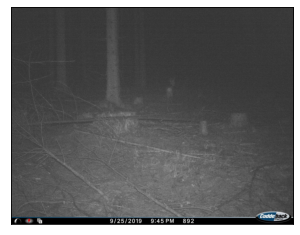

Image: 10942_I_00008c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


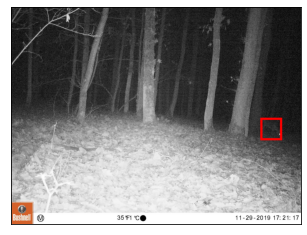

Image: 18163_11290493.JPG
True: roe_deer
Predicted: others
Confidence: 0.79


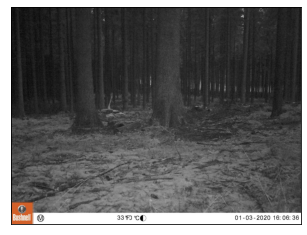

Image: 12365_01030687.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


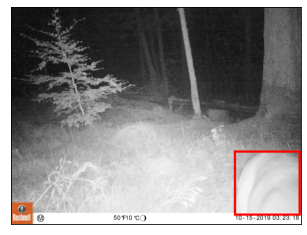

Image: 12176_10150157.JPG
True: roe_deer
Predicted: others
Confidence: 1.00


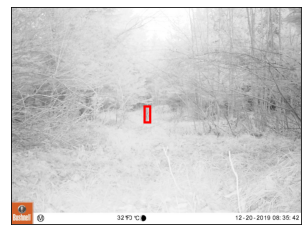

Image: 125439_12200300.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.88


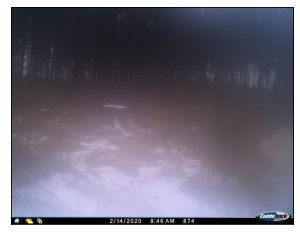

Image: 123_I_00251a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


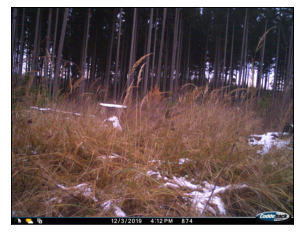

Image: 474_I_00086a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


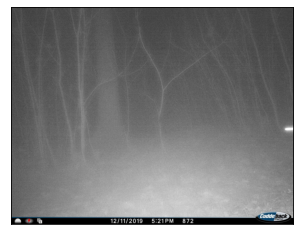

Image: 31083_I_00106c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


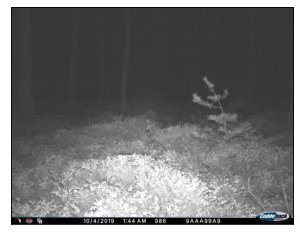

Image: 39441_I_00053b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


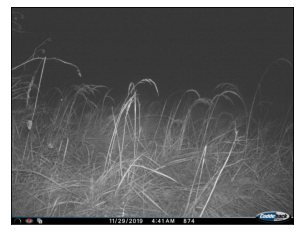

Image: 400_I_00070b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


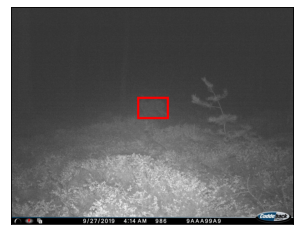

Image: 39446_I_00035c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


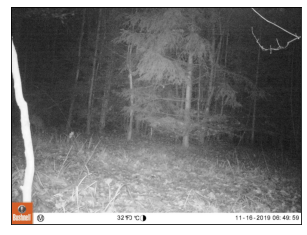

Image: 46497_11160134.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


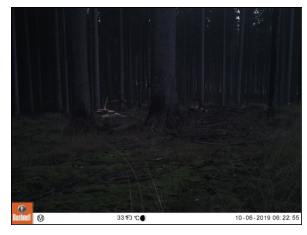

Image: 7363_10060655.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


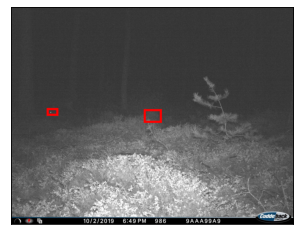

Image: 39623_I_00051b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


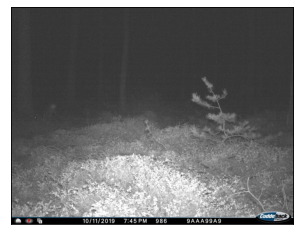

Image: 39548_I_00076c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


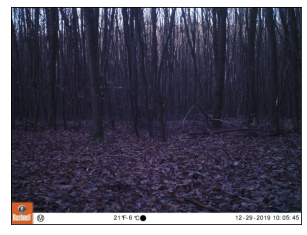

Image: 8294_12290358.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


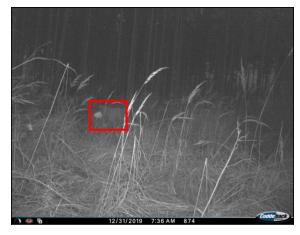

Image: 308_I_00150a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


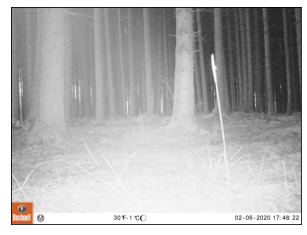

Image: 109591_02060143.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


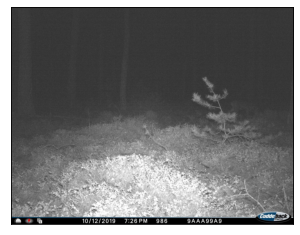

Image: 39578_I_00079c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


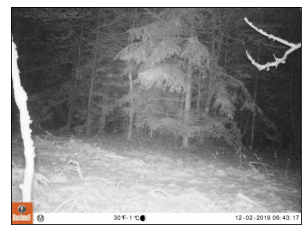

Image: 50290_12020490.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


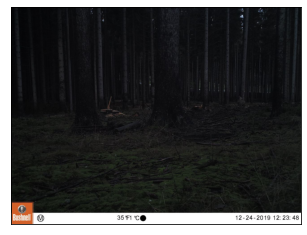

Image: 5791_12240915.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


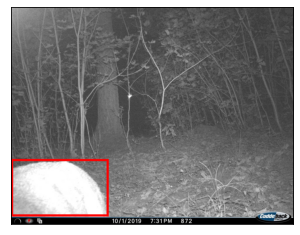

Image: 30995_I_00007b.JPG
True: roe_deer
Predicted: others
Confidence: 0.91


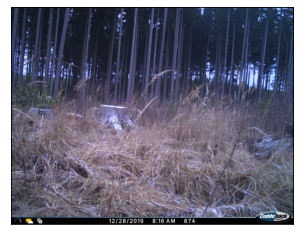

Image: 263_I_00138c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


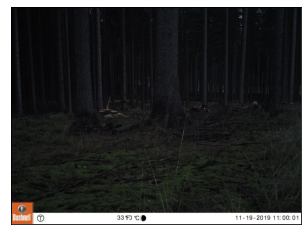

Image: 3479_11190493.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


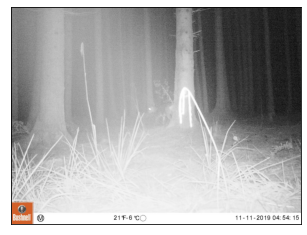

Image: 55283_11110507.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


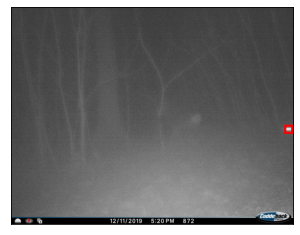

Image: 30969_I_00104a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


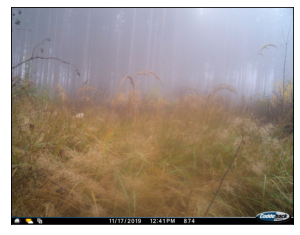

Image: 31_I_00057b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


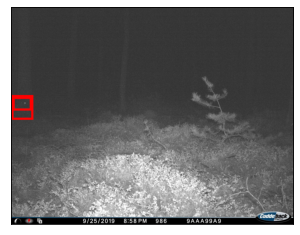

Image: 39310_I_00025a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


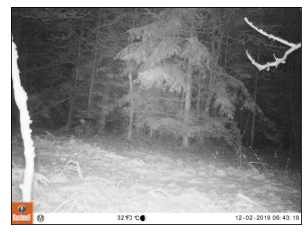

Image: 48097_12020492.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


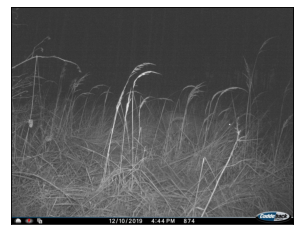

Image: 658_I_00088b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


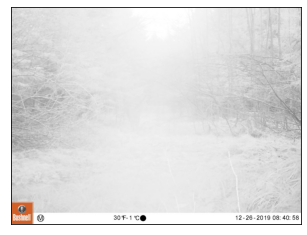

Image: 125753_12260614.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


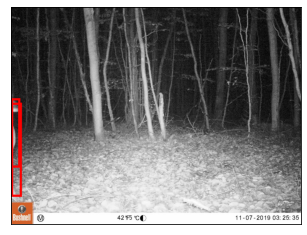

Image: 8480_11070189.JPG
True: roe_deer
Predicted: others
Confidence: 0.79


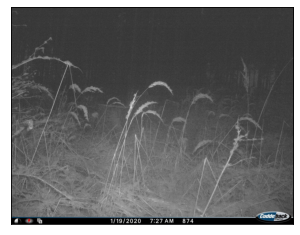

Image: 401_I_00199b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


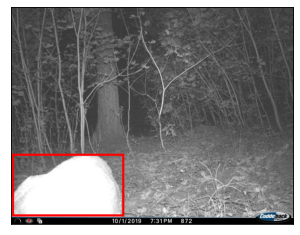

Image: 30618_I_00004c.JPG
True: roe_deer
Predicted: others
Confidence: 0.51


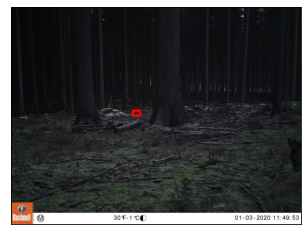

Image: 5365_01030489.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


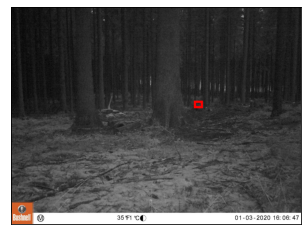

Image: 12371_01030693.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


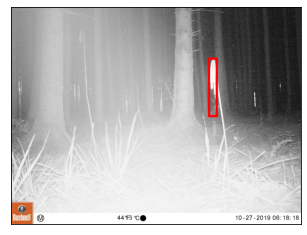

Image: 108776_10270327.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


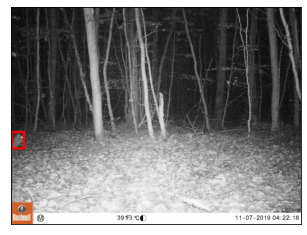

Image: 7907_11070207.JPG
True: roe_deer
Predicted: others
Confidence: 0.34


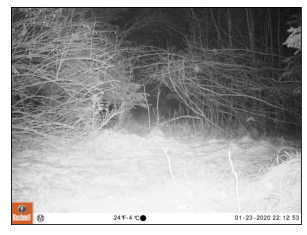

Image: 56672_01230254.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


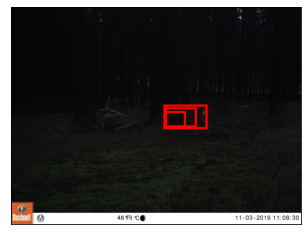

Image: 6534_11030882.JPG
True: roe_deer
Predicted: empty
Confidence: 0.92


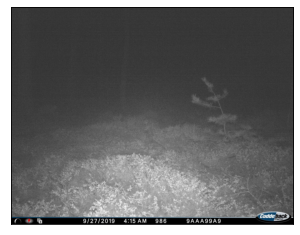

Image: 39431_I_00038a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


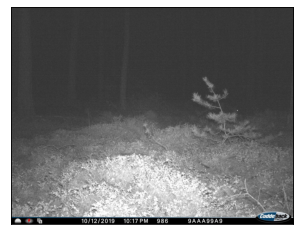

Image: 39646_I_00084b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


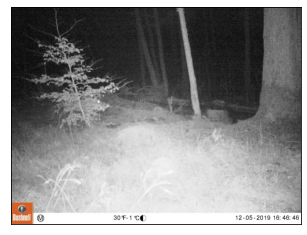

Image: 12091_12050288.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


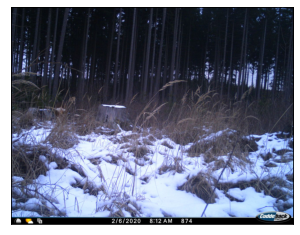

Image: 369_I_00239b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


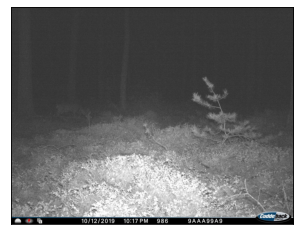

Image: 39379_I_00082c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


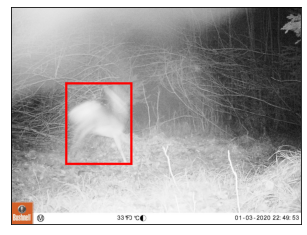

Image: 56100_01030070.JPG
True: roe_deer
Predicted: others
Confidence: 0.59


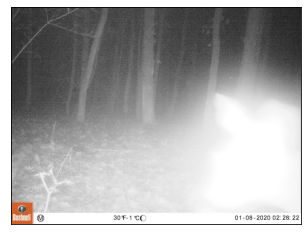

Image: 18613_01080943.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


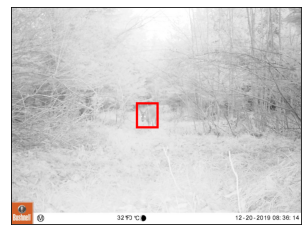

Image: 125440_12200301.JPG
True: roe_deer
Predicted: empty
Confidence: 0.75


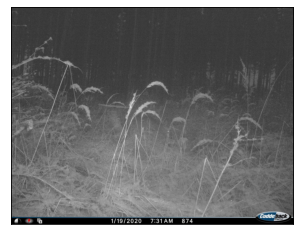

Image: 438_I_00206a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


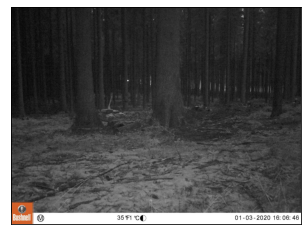

Image: 4425_01030692.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


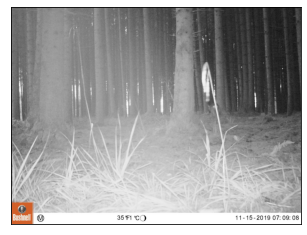

Image: 108987_11150538.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


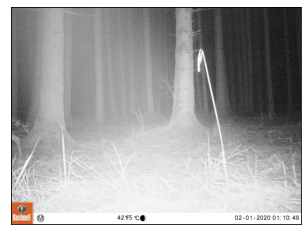

Image: 109560_02010112.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


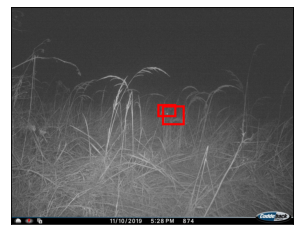

Image: 590_I_00047a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


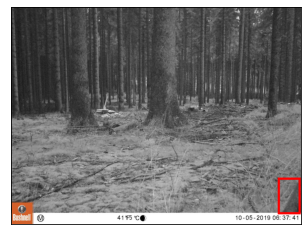

Image: 8262_10050580.JPG
True: roe_deer
Predicted: others
Confidence: 0.92


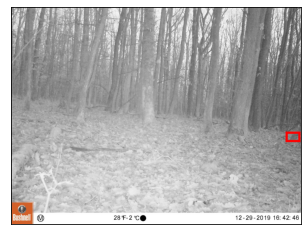

Image: 18485_12290815.JPG
True: roe_deer
Predicted: empty
Confidence: 0.80


In [211]:
random.seed(456)
true_roedeer = inspect_images(
    results=results, 
    true_label='roe_deer',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=70,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

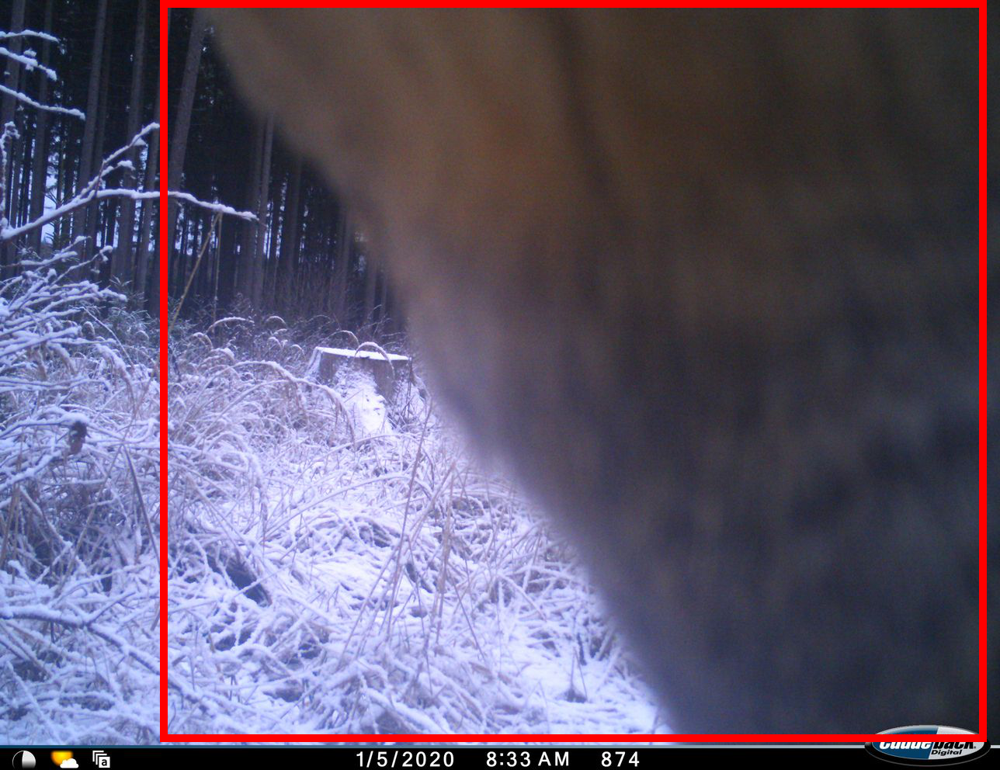

In [214]:
true_roedeer['649_I_00165a.JPG'] # close-up

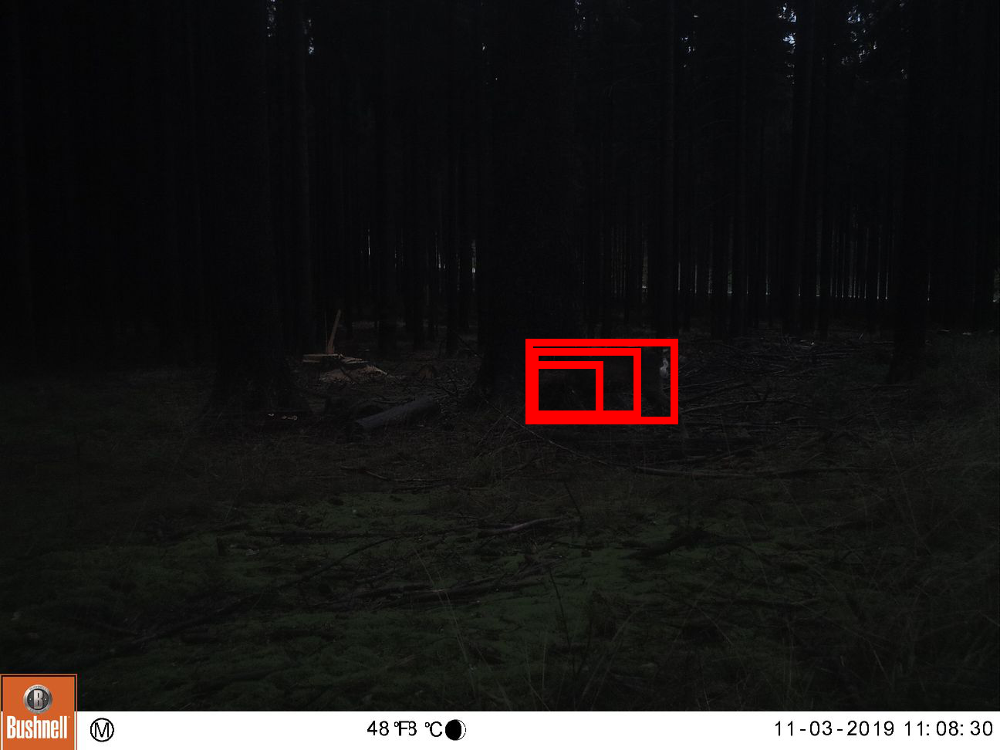

In [203]:
true_roedeer['6534_11030882.JPG'] # bad lighting

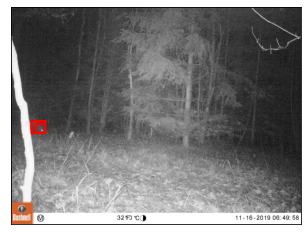

Image: 49594_11160133.JPG
True: others
Predicted: empty
Confidence: 0.84


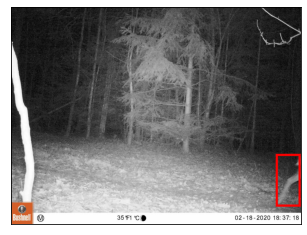

Image: 49931_02180166.JPG
True: others
Predicted: roe_deer
Confidence: 0.55


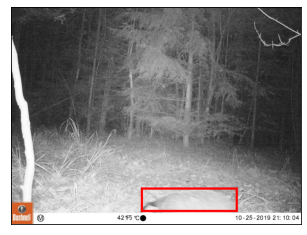

Image: 48024_10250697.JPG
True: others
Predicted: european_hare
Confidence: 0.63


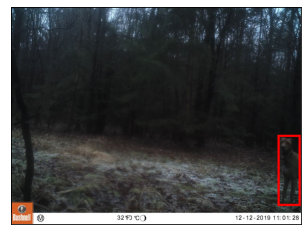

Image: 46773_12120715.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


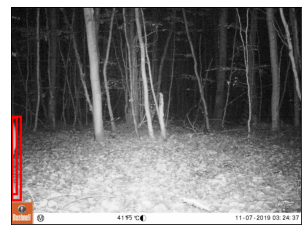

Image: 8389_11070176.JPG
True: others
Predicted: roe_deer
Confidence: 0.66


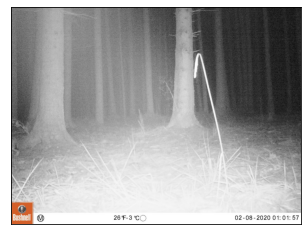

Image: 109624_02080176.JPG
True: others
Predicted: empty
Confidence: 1.00


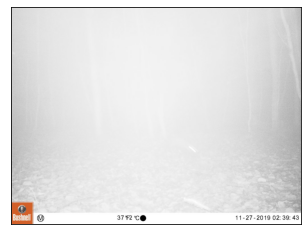

Image: 7794_11270307.JPG
True: others
Predicted: empty
Confidence: 1.00


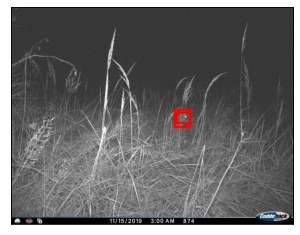

Image: 525_I_00053a.JPG
True: others
Predicted: roe_deer
Confidence: 0.79


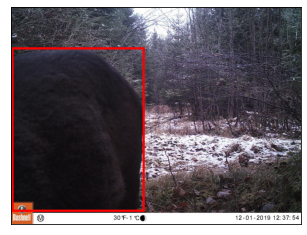

Image: 124183_12010043.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


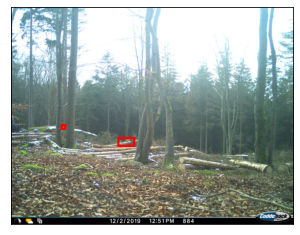

Image: 3249_I_00135b.JPG
True: others
Predicted: empty
Confidence: 1.00


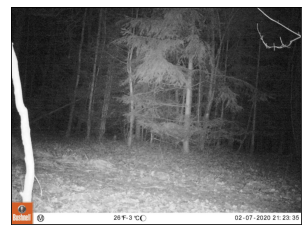

Image: 50538_02070872.JPG
True: others
Predicted: empty
Confidence: 1.00


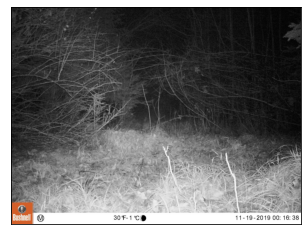

Image: 123532_11190391.JPG
True: others
Predicted: empty
Confidence: 1.00


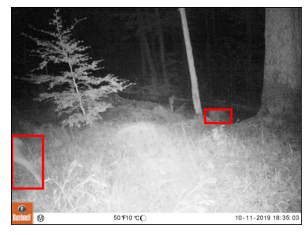

Image: 11896_10110058.JPG
True: others
Predicted: roe_deer
Confidence: 0.92


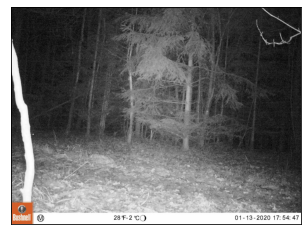

Image: 50466_01130418.JPG
True: others
Predicted: empty
Confidence: 1.00


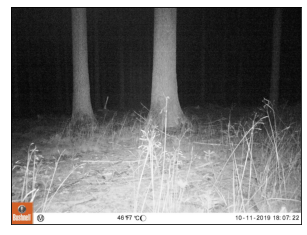

Image: 8627_10110945.JPG
True: others
Predicted: empty
Confidence: 1.00


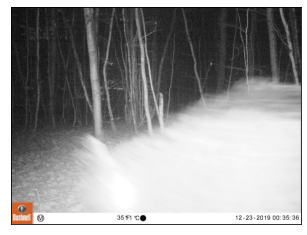

Image: 7943_12230346.JPG
True: others
Predicted: empty
Confidence: 1.00


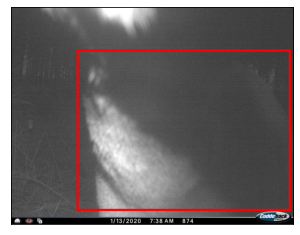

Image: 275_I_00181c.JPG
True: others
Predicted: roe_deer
Confidence: 0.78


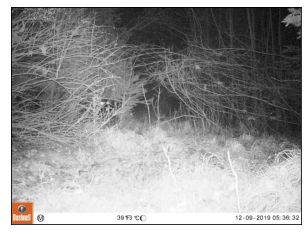

Image: 124678_12090538.JPG
True: others
Predicted: empty
Confidence: 1.00


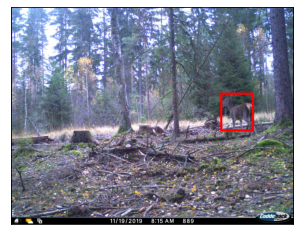

Image: 12429_I_00057a.JPG
True: others
Predicted: roe_deer
Confidence: 0.99


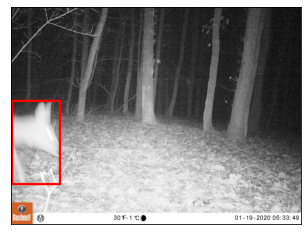

Image: 18688_01190019.JPG
True: others
Predicted: roe_deer
Confidence: 0.98


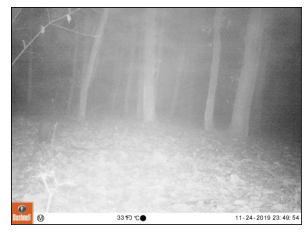

Image: 18154_11240484.JPG
True: others
Predicted: empty
Confidence: 1.00


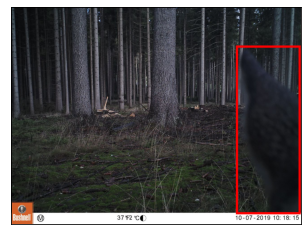

Image: 8410_10070728.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


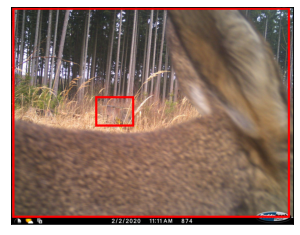

Image: 594_I_00233a.JPG
True: others
Predicted: roe_deer
Confidence: 0.99


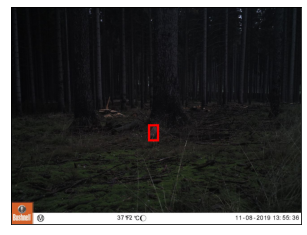

Image: 3873_11080095.JPG
True: others
Predicted: roe_deer
Confidence: 0.81


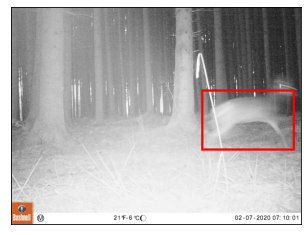

Image: 109612_02070164.JPG
True: others
Predicted: roe_deer
Confidence: 0.94


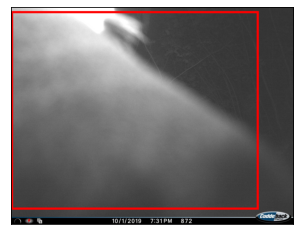

Image: 30693_I_00005b.JPG
True: others
Predicted: roe_deer
Confidence: 0.51


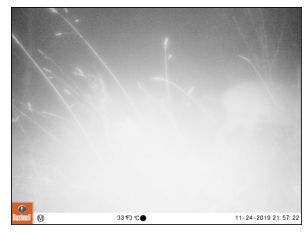

Image: 28588_11240258.JPG
True: others
Predicted: empty
Confidence: 1.00


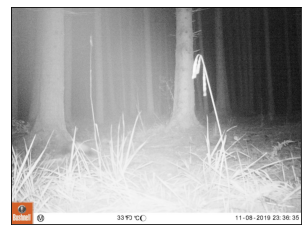

Image: 108901_11080452.JPG
True: others
Predicted: empty
Confidence: 1.00


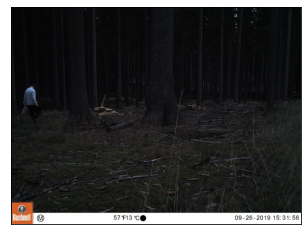

Image: 7812_09260130.JPG
True: others
Predicted: empty
Confidence: 1.00


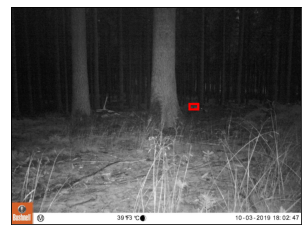

Image: 4775_10030520.JPG
True: others
Predicted: empty
Confidence: 1.00


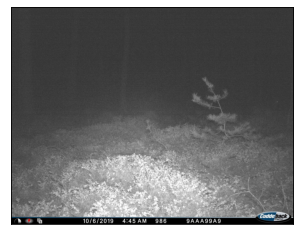

Image: 39390_I_00058b.JPG
True: others
Predicted: empty
Confidence: 1.00


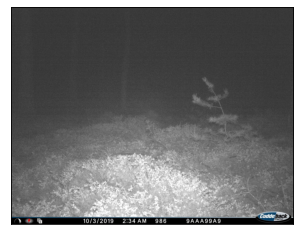

Image: 39586_I_00052c.JPG
True: others
Predicted: empty
Confidence: 1.00


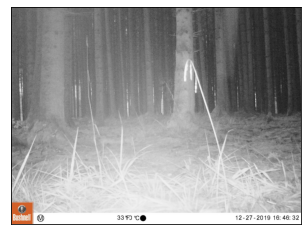

Image: 55218_12270799.JPG
True: others
Predicted: empty
Confidence: 1.00


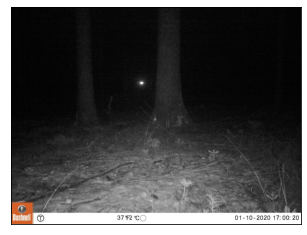

Image: 7228_01100445.JPG
True: others
Predicted: empty
Confidence: 1.00


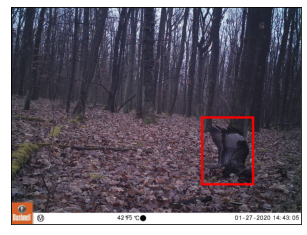

Image: 18808_01270139.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


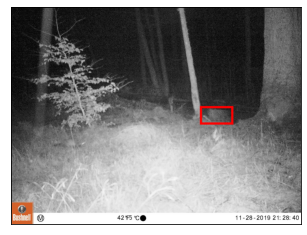

Image: 12135_11280253.JPG
True: others
Predicted: empty
Confidence: 1.00


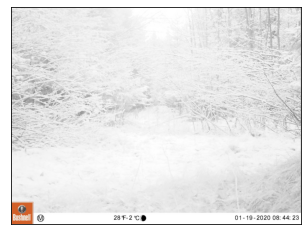

Image: 127023_01190885.JPG
True: others
Predicted: empty
Confidence: 1.00


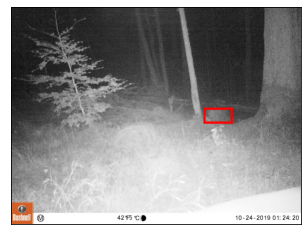

Image: 11868_10240191.JPG
True: others
Predicted: empty
Confidence: 1.00


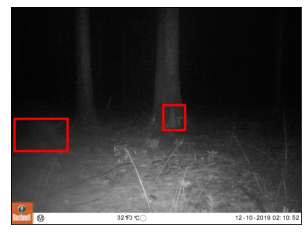

Image: 6571_12100347.JPG
True: others
Predicted: roe_deer
Confidence: 0.97


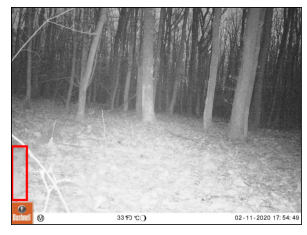

Image: 19018_02110349.JPG
True: others
Predicted: empty
Confidence: 0.87


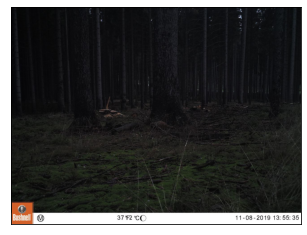

Image: 5166_11080094.JPG
True: others
Predicted: empty
Confidence: 1.00


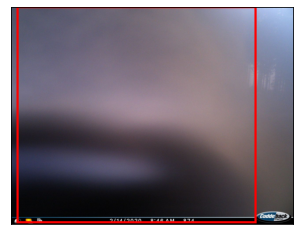

Image: 508_I_00248a.JPG
True: others
Predicted: roe_deer
Confidence: 0.53


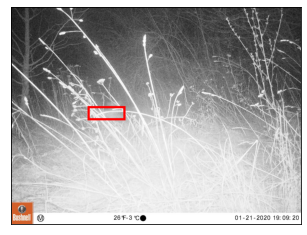

Image: 31889_01210562.JPG
True: others
Predicted: empty
Confidence: 1.00


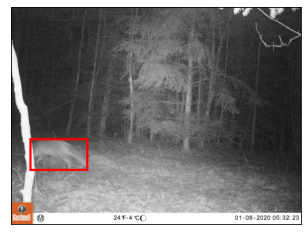

Image: 49828_01080271.JPG
True: others
Predicted: red_fox
Confidence: 1.00


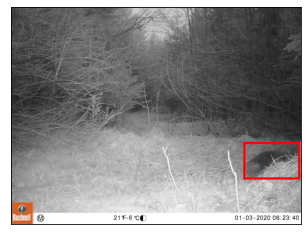

Image: 126154_01030016.JPG
True: others
Predicted: red_squirrel
Confidence: 0.99


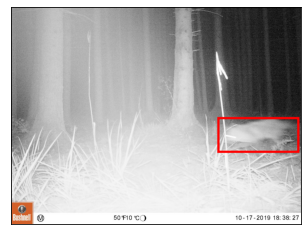

Image: 108652_10170203.JPG
True: others
Predicted: red_fox
Confidence: 1.00


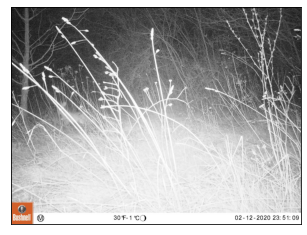

Image: 35399_02120076.JPG
True: others
Predicted: empty
Confidence: 1.00


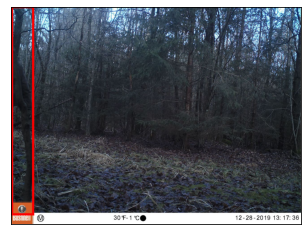

Image: 47951_12280013.JPG
True: others
Predicted: empty
Confidence: 0.74


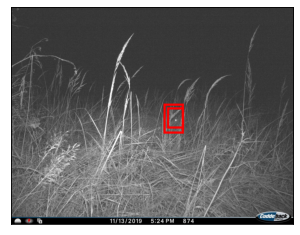

Image: 650_I_00051a.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


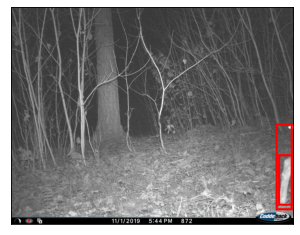

Image: 30713_I_00088a.JPG
True: others
Predicted: roe_deer
Confidence: 0.96


In [215]:
random.seed(456)
true_others = inspect_images(
    results=results, 
    true_label='others',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=50,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

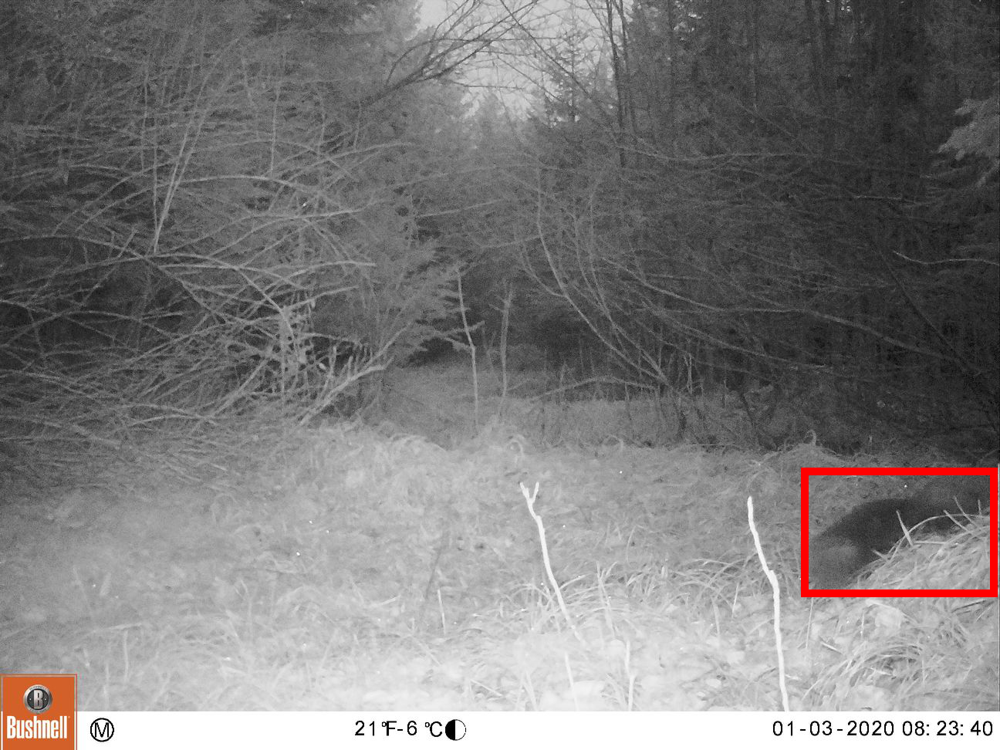

In [217]:
true_others['126154_01030016.JPG'] # occlusion

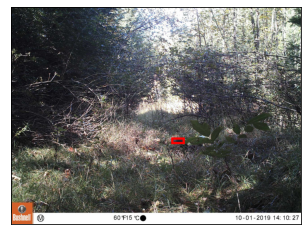

Image: 58176_10010192.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


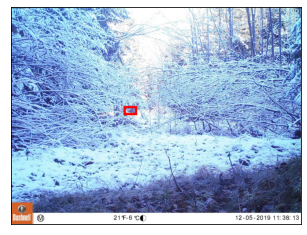

Image: 55988_12050339.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


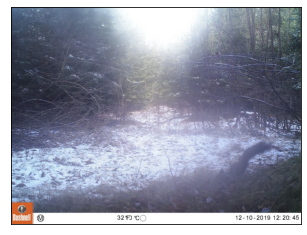

Image: 57923_12100622.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


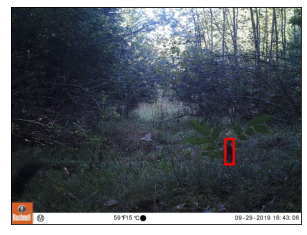

Image: 56982_09290112.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


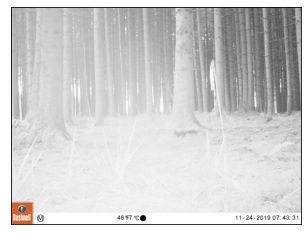

Image: 109042_11240593.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


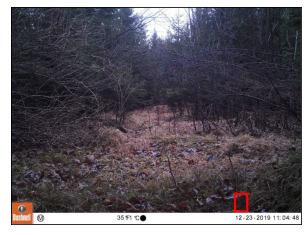

Image: 125626_12230487.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


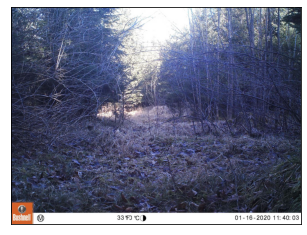

Image: 56216_01160755.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


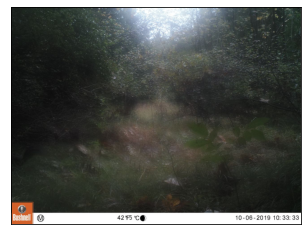

Image: 121579_10060436.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


In [218]:
random.seed(456)
true_squirrel = inspect_images(
    results=results, 
    true_label='red_squirrel',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=8,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

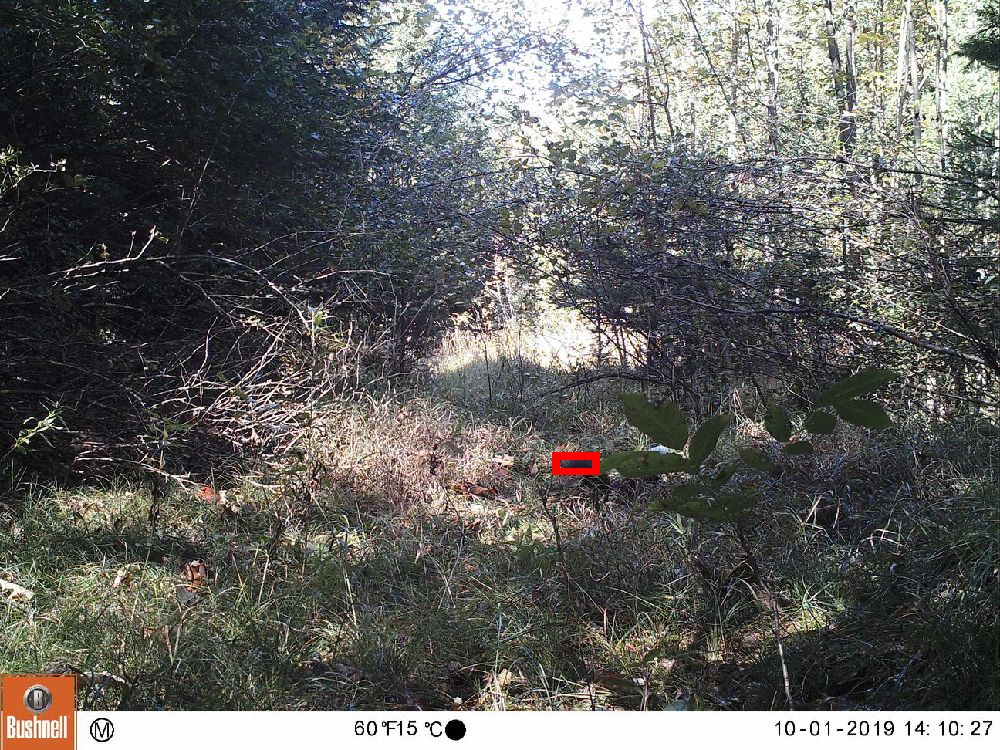

In [219]:
true_squirrel['58176_10010192.JPG'] # tiny